In [1]:
%load_ext autoreload
%autoreload 2

# Individual City Regression


In [2]:
# ruff: noqa: E402
import os
import sys
from pathlib import Path

# add the
ROOT = Path(os.getcwd())
while not (ROOT / ".git").exists():
    ROOT = ROOT.parent

sys.path.append(str(ROOT))

import polars as pl
import numpy as np
import pandas as pd

## Create the Dataset


In [3]:
from src.osm_tags import build_tag_filter
from src.config import load_config
from src.models.dataset import ServiceTimeDataset

config = load_config(ROOT / "config" / "paper.yaml")
target_tags = build_tag_filter(config)
target_tag_list = [f"{t}_{st}" for t, sts in target_tags.items() for st in sts]
super_tags = list(target_tags.keys())


dataset = (
    ServiceTimeDataset(config=config, allow_empty=True).add_super_tags().add_tags()
)

## Model Selection


In [4]:
from src.models.xgboostlss import OPT_PARAMS, OPT_PARAMS_SUB_TAGS
from src.models.conformal import ConformalModel
from src.models.xgboostlss import XGBoostLSSModel
from src.models.baseline import CityWideAverageModelDataset, KRingModelDataset
from xgboostlss.distributions import Weibull, LogNormal

In [17]:
models = [
    CityWideAverageModelDataset(
        name="City",
    ),
    KRingModelDataset(
        name="3-ring",
        k=3,
    ),
    XGBoostLSSModel(
        name="XGB-GeoVex",
        xgboost_params=OPT_PARAMS,
    ),
    XGBoostLSSModel(
        name="XGB-Subtags",
        # xgboost_params=OPT_PARAMS_SUB_TAGS,
        feature_cols=target_tag_list,
        xgboost_params=OPT_PARAMS_SUB_TAGS,
    ),
    ConformalModel(
        name="CPS",
        # model_params=OPT_PARAMS
    ),
]

### Model Evaluation


In [18]:
from time import time

results = []

for city in [
    # "Boston, USA",
    "Seattle, USA",
    # "Chicago, USA",
    # "Austin, USA",
    # "London, UK",
    # "Brussels, Belgium",
]:
    print(city)
    for kf_dataset in dataset.kfold_split(
        cities=[city], min_points_per_hex=1, k=5, seed=42 * 42, split_hex_level=True
    ):
        for model in models:
            kf_dataset.apply_model(
                model,
            )

        results.append(
            kf_dataset.score_test(
                models=models, transform_log=False, crps_n=1000
            ).with_columns(
                city=pl.lit(city),
            )
        )

    # print(f"{model.name}: {time() - t0:.2f}s")

Boston, USA
XGB-GeoVex ['0', '1', '2', '3', '4'] ['45', '46', '47', '48', '49']
XGB-Subtags ['amenity_bar', 'amenity_biergarten', 'amenity_cafe', 'amenity_fast_food', 'amenity_food_court'] ['waterway_lock_gate', 'waterway_soakhole', 'waterway_turning_point', 'waterway_water_point', 'waterway_fuel']
XGB-GeoVex ['0', '1', '2', '3', '4'] ['45', '46', '47', '48', '49']
XGB-Subtags ['amenity_bar', 'amenity_biergarten', 'amenity_cafe', 'amenity_fast_food', 'amenity_food_court'] ['waterway_lock_gate', 'waterway_soakhole', 'waterway_turning_point', 'waterway_water_point', 'waterway_fuel']
XGB-GeoVex ['0', '1', '2', '3', '4'] ['45', '46', '47', '48', '49']
XGB-Subtags ['amenity_bar', 'amenity_biergarten', 'amenity_cafe', 'amenity_fast_food', 'amenity_food_court'] ['waterway_lock_gate', 'waterway_soakhole', 'waterway_turning_point', 'waterway_water_point', 'waterway_fuel']
XGB-GeoVex ['0', '1', '2', '3', '4'] ['45', '46', '47', '48', '49']
XGB-Subtags ['amenity_bar', 'amenity_biergarten', 'ameni

In [21]:
import src.latex_tables as ltb


res_df = (
    pl.concat(results)
    .drop("mean_coverage_std", "k_fold")
    .group_by(["city", "model"])
    .agg(
        pl.all().mean(),
        pl.all().std().name.map(lambda x: f"{x}_std"),
    )
    .with_columns(
        pl.col("mean_coverage") * 100,
        pl.col("mean_coverage_std") * 100,
    )
    .with_columns(
        pl.col("model").is_in([m.name for m in models[:2]]).alias("baseline"),
        pl.col("city").str.split(",").list.first().alias("city"),
    )
    .drop("pinball_0.05")  # drop this off
)

In [25]:
fancy_df = ltb.dataframe_to_pandas(
    res_df.clone(),
    index_cols=["city", "baseline", "model"],
    bold_min_group=["city", "baseline"],
)

fancy_df = (
    fancy_df
    
    .sort_index(axis=0, ascending=[True, False, True])
    .reset_index(level=1, drop=True)
    # filter just for cities in ["Boston", "Seattle"]
    .pipe(ltb.prettify_column_names)
    .sort_index(
        axis=1,
    )
    
)
fancy_df.head()

CRPS             Mean Interval  \
                                         (s)             Coverage (\%)   
city   model                                                             
Boston 3-ring       \underline{$78.1\pm8.5$}  \underline{$90.1\pm1.2$}   
       City                     $85.8\pm9.1$              $91.2\pm1.0$   
       CPS             $\mathbf{78.2\pm8.1}$     $\mathbf{90.2\pm1.0}$   
       XGB-GeoVex               $78.5\pm8.4$              $82.0\pm1.8$   
       XGB-Subtags              $79.5\pm8.5$              $87.1\pm0.9$   

                                                                 Pinball  \
                                     Width (s)              $P_{50}$ (s)   
city   model                                                               
Boston 3-ring       \underline{$422.6\pm28.2$}  \underline{$51.2\pm5.4$}   
       City                      $478.0\pm0.0$              $55.2\pm5.4$   
       CPS                      $437.8\pm26.4$     $\mathbf{51.6\pm5.3}$   
       XGB-GeoVex      $\mathbf{320.1\pm17.7}$              $51.7\pm5.3$   
       XGB-Subtags              $366.6\pm17.3$              $52.4\pm5.4$   

                                              
                                $P_{95}$ (s)  
city   model                                  
Boston 3-ring       \underline{$28.7\pm3.3$}  
       City                     $34.5\pm3.3$  
       CPS             $\mathbf{29.6\pm3.3}$  
       XGB-GeoVex               $31.3\pm4.0$  
       XGB-Subtags              $31.6\pm3.7$

In [27]:
fancy_df.loc[["Boston", "Seattle"]].pipe(ltb.print_latex)

\begin{tabular}{lllllll}
\toprule
 &  & CRPS & \multicolumn{2}{c}{Mean Interval} & \multicolumn{2}{c}{Pinball} \\
 &  & (s) & Coverage (\%) & Width (s) & $P_{50}$ (s) & $P_{95}$ (s) \\
city & model &  &  &  &  &  \\
\midrule
\multirow[t]{5}{*}{Boston} & 3-ring & \underline{$78.1\pm8.5$} & \underline{$90.1\pm1.2$} & \underline{$422.6\pm28.2$} & \underline{$51.2\pm5.4$} & \underline{$28.7\pm3.3$} \\
 & City & $85.8\pm9.1$ & $91.2\pm1.0$ & $478.0\pm0.0$ & $55.2\pm5.4$ & $34.5\pm3.3$ \\
 & CPS & $\mathbf{78.2\pm8.1}$ & $\mathbf{90.2\pm1.0}$ & $437.8\pm26.4$ & $\mathbf{51.6\pm5.3}$ & $\mathbf{29.6\pm3.3}$ \\
 & XGB-GeoVex & $78.5\pm8.4$ & $82.0\pm1.8$ & $\mathbf{320.1\pm17.7}$ & $51.7\pm5.3$ & $31.3\pm4.0$ \\
 & XGB-Subtags & $79.5\pm8.5$ & $87.1\pm0.9$ & $366.6\pm17.3$ & $52.4\pm5.4$ & $31.6\pm3.7$ \\
\cline{1-7}
\multirow[t]{5}{*}{Seattle} & 3-ring & \underline{$71.4\pm3.3$} & \underline{$89.8\pm0.9$} & \underline{$380.1\pm11.5$} & \underline{$46.5\pm2.0$} & \underline{$26.4\pm1.5$} \\
 &

In [28]:
fancy_df.loc[["London", "Brussels"]].pipe(ltb.print_latex)

\begin{tabular}{lllllll}
\toprule
 &  & CRPS & \multicolumn{2}{c}{Mean Interval} & \multicolumn{2}{c}{Pinball} \\
 &  & (s) & Coverage (\%) & Width (s) & $P_{50}$ (s) & $P_{95}$ (s) \\
city & model &  &  &  &  &  \\
\midrule
\multirow[t]{5}{*}{London} & 3-ring & \underline{$77.4\pm2.7$} & $86.6\pm1.8$ & \underline{$412.1\pm10.1$} & \underline{$52.3\pm1.7$} & $22.6\pm1.3$ \\
 & City & $77.7\pm2.3$ & \underline{$90.8\pm0.9$} & $435.0\pm0.0$ & $53.3\pm1.4$ & \underline{$21.9\pm1.6$} \\
 & CPS & $\mathbf{77.4\pm2.7}$ & $\mathbf{91.1\pm1.3}$ & $455.9\pm18.5$ & $\mathbf{53.1\pm1.6}$ & $\mathbf{22.6\pm2.1}$ \\
 & XGB-GeoVex & $82.1\pm3.0$ & $66.5\pm0.9$ & $\mathbf{271.5\pm7.5}$ & $53.9\pm1.8$ & $28.8\pm2.4$ \\
 & XGB-Subtags & $78.3\pm2.9$ & $83.4\pm1.4$ & $384.3\pm11.1$ & $53.3\pm1.8$ & $23.7\pm1.8$ \\
\cline{1-7}
\multirow[t]{5}{*}{Brussels} & 3-ring & $67.7\pm2.2$ & $87.5\pm1.0$ & \underline{$371.2\pm2.9$} & $46.7\pm1.5$ & $16.9\pm0.6$ \\
 & City & \underline{$67.1\pm2.1$} & \underline{$91

## Compare Train on Cities - Boston vs. Train on Boston Test on Boston


In [29]:
from src.models.xgboostlss import XGBoostLSSModel
from src.models.conformal import ConformalModel

models = [
    XGBoostLSSModel(
        name="XGB-GeoVex_Transfer",
        xgboost_params=OPT_PARAMS,
    ),
    ConformalModel(
        name="CPS_Transfer",
        # model_params=OPT_PARAMS
    ),
    XGBoostLSSModel(
        name="XGB-GeoVex_City",
        xgboost_params=OPT_PARAMS,
    ),
    ConformalModel(
        name="CPS_City",
        # model_params=OPT_PARAMS
    ),
    XGBoostLSSModel(
        name="XGB-GeoVex_Full",
        xgboost_params=OPT_PARAMS,
    ),
    ConformalModel(
        name="CPS_Full",
        # model_params=OPT_PARAMS
    ),
]

In [30]:
whole_city_dataset = dataset.copy().split_test_train(
    train_cities=["Seattle, USA", "Austin, USA", "Chicago, USA"],
    test_cities=["Boston, USA"],
    min_points_per_hex_train=1,
    min_points_per_hex_test=1,
    whole_city_test=True,
)


for model in models[:2]:
    model.train(whole_city_dataset)

Test cities are not a subset of train cities. Setting train size to 1.0
XGB-GeoVex_Transfer ['0', '1', '2', '3', '4'] ['45', '46', '47', '48', '49']


In [31]:
training_results = []

for kf_dataset in whole_city_dataset.kfold_split(
    cities=["Boston, USA"],
    min_points_per_hex=5,
    k=5,
    seed=42,
):
    for model in [models[2], models[3]]:
        model.train(kf_dataset)

    for model in models[4:]:
        model.train(
            kf_dataset.copy().set_train_df(
                pl.concat([kf_dataset.train_df, whole_city_dataset.train_df]),
                override=True,
            )
        )

    for model in models:
        kf_dataset.test_apply_model(
            model,
        )

    training_results.append(
        kf_dataset.score_test(
            models=models,
            transform_log=False,
        ).with_columns(
            city=pl.lit("Boston, USA"),
        )
    )

XGB-GeoVex_City ['0', '1', '2', '3', '4'] ['45', '46', '47', '48', '49']
XGB-GeoVex_Full ['0', '1', '2', '3', '4'] ['45', '46', '47', '48', '49']
XGB-GeoVex_City ['0', '1', '2', '3', '4'] ['45', '46', '47', '48', '49']
XGB-GeoVex_Full ['0', '1', '2', '3', '4'] ['45', '46', '47', '48', '49']
XGB-GeoVex_City ['0', '1', '2', '3', '4'] ['45', '46', '47', '48', '49']
XGB-GeoVex_Full ['0', '1', '2', '3', '4'] ['45', '46', '47', '48', '49']
XGB-GeoVex_City ['0', '1', '2', '3', '4'] ['45', '46', '47', '48', '49']
XGB-GeoVex_Full ['0', '1', '2', '3', '4'] ['45', '46', '47', '48', '49']
XGB-GeoVex_City ['0', '1', '2', '3', '4'] ['45', '46', '47', '48', '49']
XGB-GeoVex_Full ['0', '1', '2', '3', '4'] ['45', '46', '47', '48', '49']


In [32]:
res_df = (
    pl.concat(training_results)
    .with_columns(
        pl.col("model").str.split("_").list.last().alias("Scheme"),
        pl.col("model").str.split("_").list.first().alias("Model"),
    )
    .drop("mean_coverage_std", "k_fold", "model", "city")
    .group_by(["Model", "Scheme"])
    .agg(
        pl.all().mean(),
        pl.all().std().name.map(lambda x: f"{x}_std"),
    )
    .with_columns(
        pl.col("mean_coverage") * 100,
        pl.col("mean_coverage_std") * 100,
        pl.lit(False).alias("baseline"),
    )
    .drop(["pinball_0.05", "generalized", "model", "city"])  # drop this off
)

In [33]:
res_df.head()

Model,Scheme,crps,mean_coverage,mean_interval_width,MAE_0.5,pinball_0.5,pinball_0.95,crps_std,mean_coverage_std,mean_interval_width_std,MAE_0.5_std,pinball_0.05_std,pinball_0.5_std,pinball_0.95_std,baseline
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,bool
"""CPS""","""City""",80.54266,90.055457,436.992776,103.398324,51.699162,29.475579,1.848898,1.288859,27.399375,2.410416,0.238139,1.205208,0.896023,false
"""XGB-GeoVex""","""City""",80.661686,86.060032,350.215156,103.597313,51.798656,30.792902,1.804522,1.082677,11.22346,2.024707,0.212584,1.012353,0.555835,false
"""CPS""","""Full""",80.371963,87.532254,394.892399,102.988315,51.494157,29.537676,1.500602,0.92851,13.317253,1.997486,0.34365,0.998743,0.659892,false
"""XGB-GeoVex""","""Full""",80.133466,86.428055,342.131863,103.08606,51.54303,30.416473,1.979019,1.142439,10.590179,2.379421,0.260312,1.189711,0.770745,false
"""XGB-GeoVex""","""Transfer""",83.150366,80.998108,278.301529,104.910489,52.455245,36.669233,2.628951,0.953952,2.569003,2.830434,0.22803,1.415217,1.969113,false


In [34]:
fancy_df = ltb.dataframe_to_pandas(
    res_df.clone(), index_cols=["Scheme", "Model"], bold_min_group=["baseline"]
).drop("baseline", axis=1)

fancy_df = fancy_df.pipe(ltb.prettify_column_names)
fancy_df.head()

CRPS          Mean Interval  \
                                       (s)          Coverage (\%)   
Scheme   Model                                                      
City     CPS                  $80.5\pm1.8$  $\mathbf{90.1\pm1.3}$   
         XGB-GeoVex           $80.7\pm1.8$           $86.1\pm1.1$   
Full     CPS                  $80.4\pm1.5$           $87.5\pm0.9$   
         XGB-GeoVex  $\mathbf{80.1\pm2.0}$           $86.4\pm1.1$   
Transfer CPS                  $82.0\pm2.3$           $86.3\pm1.0$   

                                                   Pinball  \
                          Width (s)           $P_{50}$ (s)   
Scheme   Model                                               
City     CPS         $437.0\pm27.4$           $51.7\pm1.2$   
         XGB-GeoVex  $350.2\pm11.2$           $51.8\pm1.0$   
Full     CPS         $394.9\pm13.3$  $\mathbf{51.5\pm1.0}$   
         XGB-GeoVex  $342.1\pm10.6$           $51.5\pm1.2$   
Transfer CPS          $362.7\pm7.3$           $52.6\pm1.5$   

                                            
                              $P_{95}$ (s)  
Scheme   Model                              
City     CPS                  $29.5\pm0.9$  
         XGB-GeoVex           $30.8\pm0.6$  
Full     CPS         $\mathbf{29.5\pm0.7}$  
         XGB-GeoVex           $30.4\pm0.8$  
Transfer CPS                  $32.2\pm1.2$

In [35]:
fancy_df.pipe(ltb.print_latex)

\begin{tabular}{lllllll}
\toprule
 &  & CRPS & \multicolumn{2}{c}{Mean Interval} & \multicolumn{2}{c}{Pinball} \\
 &  & (s) & Coverage (\%) & Width (s) & $P_{50}$ (s) & $P_{95}$ (s) \\
Scheme & Model &  &  &  &  &  \\
\midrule
\multirow[t]{2}{*}{City} & CPS & $80.5\pm1.8$ & $\mathbf{90.1\pm1.3}$ & $437.0\pm27.4$ & $51.7\pm1.2$ & $29.5\pm0.9$ \\
 & XGB-GeoVex & $80.7\pm1.8$ & $86.1\pm1.1$ & $350.2\pm11.2$ & $51.8\pm1.0$ & $30.8\pm0.6$ \\
\cline{1-7}
\multirow[t]{2}{*}{Full} & CPS & $80.4\pm1.5$ & $87.5\pm0.9$ & $394.9\pm13.3$ & $\mathbf{51.5\pm1.0}$ & $\mathbf{29.5\pm0.7}$ \\
 & XGB-GeoVex & $\mathbf{80.1\pm2.0}$ & $86.4\pm1.1$ & $342.1\pm10.6$ & $51.5\pm1.2$ & $30.4\pm0.8$ \\
\cline{1-7}
\multirow[t]{2}{*}{Transfer} & CPS & $82.0\pm2.3$ & $86.3\pm1.0$ & $362.7\pm7.3$ & $52.6\pm1.5$ & $32.2\pm1.2$ \\
 & XGB-GeoVex & $83.2\pm2.6$ & $81.0\pm1.0$ & $\mathbf{278.3\pm2.6}$ & $52.5\pm1.4$ & $36.7\pm2.0$ \\
\cline{1-7}
\bottomrule
\end{tabular}



In [ ]:
import optuna
from optuna.samplers import TPESampler
from xgboost import XGBModel
from sklearn.metrics import mean_squared_error
import numpy as np

# make the dataset
dataset = ServiceTimeDataset(
    config=load_config(ROOT / "config" / "paper.yaml"),
).split_test_train(
    train_cities=["Boston, USA"],
    test_cities=["Boston, USA"],
    min_points_per_hex_test=5,
    min_points_per_hex_train=5,
    seed=42,
    train_size=0.99,
)


kfold_indices = get_kfolds(dataset, 5)

# X_train = dataset.train_feature_array
# y_train = dataset.train_label_array

# X_valid = dataset.test_feature_array
# y_valid = dataset.test_df[dataset.pred_col].to_numpy()


def objective(trial):
    param_grid = {
        "objective": trial.suggest_categorical(
            "objective", ["reg:tweedie", "reg:squarederror", "reg:squaredlogerror"]
        ),
        "tweedie_variance_power": trial.suggest_discrete_uniform(
            "tweedie_variance_power", 1.0, 2.0, 0.1
        ),
        "max_depth": trial.suggest_int(
            "max_depth", 6, 10
        ),  # Extremely prone to overfitting!
        "n_estimators": trial.suggest_int(
            "n_estimators", 400, 4000, 400
        ),  # Extremely prone to overfitting!
        "eta": trial.suggest_float("eta", 0.007, 0.1),  # Most important parameter.
        "subsample": trial.suggest_discrete_uniform("subsample", 0.2, 0.9, 0.1),
        "colsample_bytree": trial.suggest_discrete_uniform(
            "colsample_bytree", 0.2, 0.9, 0.1
        ),
        "colsample_bylevel": trial.suggest_discrete_uniform(
            "colsample_bylevel", 0.2, 0.9, 0.1
        ),
        "min_child_weight": trial.suggest_loguniform(
            "min_child_weight", 1e-4, 1e4
        ),  # I've had trouble with LB score until tuning this.
        "reg_lambda": trial.suggest_loguniform(
            "reg_lambda", 1e-4, 1e4
        ),  # L2 regularization
        "reg_alpha": trial.suggest_loguniform(
            "reg_alpha", 1e-4, 1e4
        ),  # L1 regularization
        "gamma": trial.suggest_loguniform("gamma", 1e-4, 10),
        "tree_method": "hist",
    }

    reg = XGBModel(
        # These parameters should help with trial speed.
        # objective="reg:tweedie",
        # tree_method='gpu_hist',
        # predictor='gpu_predictor',
        n_jobs=8,
        **param_grid,
    )

    scores = []
    for fold in kfold_indices:
        X_train = dataset.train_feature_array[fold[0]]
        y_train = dataset.train_label_array[fold[0]]

        X_valid = dataset.train_feature_array[fold[1]]
        y_valid = dataset.train_label_array[fold[1]]

        try:
            reg.fit(
                X_train,
                y_train,
                eval_set=[(X_valid, y_valid)],
                eval_metric="rmse",
                verbose=False,
            )
        except Exception as e:
            # print(e)
            return 1e10

        scores.append(np.sqrt(mean_squared_error(y_valid, reg.predict(X_valid))))

        # Returns the best RMSE for the trial.
    # Readers may want to try returning a cross validation score here.
    return np.mean(scores)


train_time = 1 * 30 * 60
study = optuna.create_study(
    direction="minimize", sampler=TPESampler(), study_name="XGBRegressor"
)
study.optimize(objective, timeout=train_time, show_progress_bar=True, n_jobs=1)

[I 2024-01-31 13:48:22,480] A new study created in memory with name: XGBRegressor


   0%|          | 00:00/30:00

suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:48:42,800] Trial 0 finished with value: 207.94943850942542 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.1, 'max_depth': 8, 'n_estimators': 800, 'eta': 0.09217316603236224, 'subsample': 0.4, 'colsample_bytree': 0.2, 'colsample_bylevel': 0.5, 'min_child_weight': 0.00043305121627633256, 'reg_lambda': 164.59766320567465, 'reg_alpha': 26.42082693825832, 'gamma': 0.00021622741934177917}. Best is trial 0 with value: 207.94943850942542.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:49:49,057] Trial 1 finished with value: 206.884957679072 and parameters: {'objective': 'reg:tweedie', 'tweedie_variance_power': 1.3, 'max_depth': 7, 'n_estimators': 3600, 'eta': 0.017290938574443325, 'subsample': 0.6000000000000001, 'colsample_bytree': 0.4, 'colsample_bylevel': 0.6000000000000001, 'min_child_weight': 409.97322283269193, 'reg_lambda': 0.00039292452062151715, 'reg_alpha': 0.09770710166424448, 'gamma': 0.0015186792591269478}. Best is trial 1 with value: 206.884957679072.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:50:20,576] Trial 2 finished with value: 205.86323166177516 and parameters: {'objective': 'reg:tweedie', 'tweedie_variance_power': 1.3, 'max_depth': 10, 'n_estimators': 1600, 'eta': 0.01926819885117929, 'subsample': 0.9, 'colsample_bytree': 0.6000000000000001, 'colsample_bylevel': 0.2, 'min_child_weight': 0.000968880021404952, 'reg_lambda': 0.004170797407483195, 'reg_alpha': 140.86556171168033, 'gamma': 4.188997573051523}. Best is trial 2 with value: 205.86323166177516.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:50:31,293] Trial 3 finished with value: 205.20848636458913 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 2.0, 'max_depth': 9, 'n_estimators': 400, 'eta': 0.010433832366445343, 'subsample': 0.9, 'colsample_bytree': 0.2, 'colsample_bylevel': 0.5, 'min_child_weight': 0.23224977167756578, 'reg_lambda': 230.70516938586965, 'reg_alpha': 5.48132669296193, 'gamma': 0.012265403022585325}. Best is trial 3 with value: 205.20848636458913.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:50:38,351] Trial 4 finished with value: 205.22761751513298 and parameters: {'objective': 'reg:tweedie', 'tweedie_variance_power': 1.9, 'max_depth': 6, 'n_estimators': 800, 'eta': 0.08140082141461716, 'subsample': 0.30000000000000004, 'colsample_bytree': 0.2, 'colsample_bylevel': 0.9, 'min_child_weight': 0.9259203261005939, 'reg_lambda': 1186.9764451309122, 'reg_alpha': 24.829014168033325, 'gamma': 7.558787534356556}. Best is trial 3 with value: 205.20848636458913.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:51:24,898] Trial 5 finished with value: 213.39179879523584 and parameters: {'objective': 'reg:tweedie', 'tweedie_variance_power': 1.8, 'max_depth': 9, 'n_estimators': 1600, 'eta': 0.030668122144796823, 'subsample': 0.8, 'colsample_bytree': 0.4, 'colsample_bylevel': 0.6000000000000001, 'min_child_weight': 0.04879699320175821, 'reg_lambda': 0.026927342795475286, 'reg_alpha': 0.0022377779955424187, 'gamma': 0.0001237446029023025}. Best is trial 3 with value: 205.20848636458913.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:51:39,968] Trial 6 finished with value: 206.79140697265348 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.5, 'max_depth': 6, 'n_estimators': 1200, 'eta': 0.037747058329492184, 'subsample': 0.30000000000000004, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.4, 'min_child_weight': 125.35428875722498, 'reg_lambda': 3.706593609997398, 'reg_alpha': 164.1606228383317, 'gamma': 0.0020872666622477752}. Best is trial 3 with value: 205.20848636458913.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:52:07,413] Trial 7 finished with value: 205.21144381489643 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.3, 'max_depth': 7, 'n_estimators': 1600, 'eta': 0.018493746323397637, 'subsample': 0.30000000000000004, 'colsample_bytree': 0.9, 'colsample_bylevel': 0.6000000000000001, 'min_child_weight': 73.39472357571334, 'reg_lambda': 3829.6580394581474, 'reg_alpha': 1.8299345443450319, 'gamma': 5.837182168179028}. Best is trial 3 with value: 205.20848636458913.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:52:43,592] Trial 8 finished with value: 204.93755958561093 and parameters: {'objective': 'reg:tweedie', 'tweedie_variance_power': 2.0, 'max_depth': 9, 'n_estimators': 3600, 'eta': 0.06425032615347082, 'subsample': 0.30000000000000004, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.30000000000000004, 'min_child_weight': 107.30687082562343, 'reg_lambda': 5999.7422982955, 'reg_alpha': 4.63100165975777, 'gamma': 0.6938035409187494}. Best is trial 8 with value: 204.93755958561093.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:53:12,454] Trial 9 finished with value: 264.5094681305394 and parameters: {'objective': 'reg:squaredlogerror', 'tweedie_variance_power': 1.2, 'max_depth': 9, 'n_estimators': 4000, 'eta': 0.011557654493286855, 'subsample': 0.5, 'colsample_bytree': 0.5, 'colsample_bylevel': 0.5, 'min_child_weight': 0.0008495085829968334, 'reg_lambda': 1816.922116018919, 'reg_alpha': 0.0003571295243587335, 'gamma': 0.14785289733071352}. Best is trial 8 with value: 204.93755958561093.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:53:32,431] Trial 10 finished with value: 279.8165798208288 and parameters: {'objective': 'reg:squaredlogerror', 'tweedie_variance_power': 1.7000000000000002, 'max_depth': 10, 'n_estimators': 2800, 'eta': 0.059571738488468834, 'subsample': 0.2, 'colsample_bytree': 0.9, 'colsample_bylevel': 0.2, 'min_child_weight': 6910.4117296994855, 'reg_lambda': 1.7552824152602131, 'reg_alpha': 7583.6370399310135, 'gamma': 0.29384287006211396}. Best is trial 8 with value: 204.93755958561093.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:54:34,205] Trial 11 finished with value: 210.8839651573391 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 2.0, 'max_depth': 9, 'n_estimators': 2800, 'eta': 0.06318975140824927, 'subsample': 0.7, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.30000000000000004, 'min_child_weight': 1.7500805019527983, 'reg_lambda': 47.79775160161004, 'reg_alpha': 0.1989095093983178, 'gamma': 0.021902599770890898}. Best is trial 8 with value: 204.93755958561093.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:55:37,701] Trial 12 finished with value: 214.19169877999084 and parameters: {'objective': 'reg:tweedie', 'tweedie_variance_power': 1.6, 'max_depth': 8, 'n_estimators': 2400, 'eta': 0.04508287064017005, 'subsample': 0.9, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.8, 'min_child_weight': 1.1769797437315368, 'reg_lambda': 62.37938723603832, 'reg_alpha': 1.9327555543243564, 'gamma': 0.04288605178296792}. Best is trial 8 with value: 204.93755958561093.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:55:46,833] Trial 13 finished with value: 205.86193318046372 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 2.0, 'max_depth': 9, 'n_estimators': 400, 'eta': 0.07067697497576657, 'subsample': 0.6000000000000001, 'colsample_bytree': 0.30000000000000004, 'colsample_bylevel': 0.4, 'min_child_weight': 0.03786210951093449, 'reg_lambda': 8253.005424853449, 'reg_alpha': 2419.2529649923304, 'gamma': 0.2875544887271668}. Best is trial 8 with value: 204.93755958561093.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:56:10,733] Trial 14 finished with value: 256.30800130033657 and parameters: {'objective': 'reg:squaredlogerror', 'tweedie_variance_power': 1.8, 'max_depth': 10, 'n_estimators': 3200, 'eta': 0.04974691436850051, 'subsample': 0.5, 'colsample_bytree': 0.8, 'colsample_bylevel': 0.4, 'min_child_weight': 9.913717473779203, 'reg_lambda': 332.4261475425721, 'reg_alpha': 0.03065506775074769, 'gamma': 0.006000004560004821}. Best is trial 8 with value: 204.93755958561093.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:57:35,780] Trial 15 finished with value: 239.8300521940515 and parameters: {'objective': 'reg:tweedie', 'tweedie_variance_power': 1.5, 'max_depth': 8, 'n_estimators': 4000, 'eta': 0.07275749363493485, 'subsample': 0.7, 'colsample_bytree': 0.5, 'colsample_bylevel': 0.30000000000000004, 'min_child_weight': 0.037229381620163225, 'reg_lambda': 20.612132646209425, 'reg_alpha': 7.480086918108796, 'gamma': 1.0424330800316919}. Best is trial 8 with value: 204.93755958561093.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:57:58,824] Trial 16 finished with value: 208.07139151387656 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 2.0, 'max_depth': 9, 'n_estimators': 2400, 'eta': 0.09922966246397111, 'subsample': 0.2, 'colsample_bytree': 0.6000000000000001, 'colsample_bylevel': 0.7, 'min_child_weight': 1052.3958627045158, 'reg_lambda': 0.08063157049081542, 'reg_alpha': 431.06368598190846, 'gamma': 0.03984287375080047}. Best is trial 8 with value: 204.93755958561093.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:58:48,780] Trial 17 finished with value: 211.97010445479242 and parameters: {'objective': 'reg:tweedie', 'tweedie_variance_power': 1.8, 'max_depth': 7, 'n_estimators': 3200, 'eta': 0.03607356508699653, 'subsample': 0.4, 'colsample_bytree': 0.30000000000000004, 'colsample_bylevel': 0.30000000000000004, 'min_child_weight': 22.872450779649064, 'reg_lambda': 10.116154258390699, 'reg_alpha': 0.013371102402757209, 'gamma': 1.0766286833425958}. Best is trial 8 with value: 204.93755958561093.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 13:59:37,974] Trial 18 finished with value: 230.00660456922975 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.9, 'max_depth': 10, 'n_estimators': 2000, 'eta': 0.05859526136590177, 'subsample': 0.8, 'colsample_bytree': 0.8, 'colsample_bylevel': 0.7, 'min_child_weight': 0.27004327197266303, 'reg_lambda': 0.3085405643783156, 'reg_alpha': 0.3791988461671381, 'gamma': 0.012526654206343395}. Best is trial 8 with value: 204.93755958561093.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:00:07,206] Trial 19 finished with value: 235.73346727522312 and parameters: {'objective': 'reg:squaredlogerror', 'tweedie_variance_power': 1.0, 'max_depth': 9, 'n_estimators': 3600, 'eta': 0.0818994913135167, 'subsample': 0.4, 'colsample_bytree': 0.4, 'colsample_bylevel': 0.5, 'min_child_weight': 0.008614543640587521, 'reg_lambda': 277.21658082697684, 'reg_alpha': 6.73945884799429, 'gamma': 0.10142871516568484}. Best is trial 8 with value: 204.93755958561093.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:00:15,658] Trial 20 finished with value: 205.58634135800816 and parameters: {'objective': 'reg:tweedie', 'tweedie_variance_power': 1.6, 'max_depth': 8, 'n_estimators': 400, 'eta': 0.045176394735678416, 'subsample': 0.7, 'colsample_bytree': 0.8, 'colsample_bylevel': 0.4, 'min_child_weight': 5.544260762675617, 'reg_lambda': 8466.906347849199, 'reg_alpha': 0.8597333648345131, 'gamma': 1.3405145495937154}. Best is trial 8 with value: 204.93755958561093.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:00:39,876] Trial 21 finished with value: 205.23376609527705 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.4, 'max_depth': 7, 'n_estimators': 1200, 'eta': 0.007930910966486284, 'subsample': 0.30000000000000004, 'colsample_bytree': 0.9, 'colsample_bylevel': 0.7, 'min_child_weight': 45.22518446730231, 'reg_lambda': 1111.0278704258849, 'reg_alpha': 4.061051986148572, 'gamma': 3.7828982283046515}. Best is trial 8 with value: 204.93755958561093.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:00:53,660] Trial 22 finished with value: 218.32643754152414 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.3, 'max_depth': 7, 'n_estimators': 2000, 'eta': 0.023932243373557566, 'subsample': 0.2, 'colsample_bytree': 0.9, 'colsample_bylevel': 0.6000000000000001, 'min_child_weight': 2652.6507512225676, 'reg_lambda': 7537.049041620341, 'reg_alpha': 33.56531668623103, 'gamma': 1.6482246913983765}. Best is trial 8 with value: 204.93755958561093.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:01:19,955] Trial 23 finished with value: 204.4531001992031 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.9, 'max_depth': 8, 'n_estimators': 1600, 'eta': 0.0244317757684199, 'subsample': 0.30000000000000004, 'colsample_bytree': 0.8, 'colsample_bylevel': 0.8, 'min_child_weight': 175.26004564476892, 'reg_lambda': 1320.385431944243, 'reg_alpha': 1.0193124665081958, 'gamma': 0.48854670937122824}. Best is trial 23 with value: 204.4531001992031.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:01:34,485] Trial 24 finished with value: 204.13467170359064 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.9, 'max_depth': 8, 'n_estimators': 800, 'eta': 0.02796266037521193, 'subsample': 0.5, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.9, 'min_child_weight': 313.9119269982732, 'reg_lambda': 546.3882281040694, 'reg_alpha': 0.05266428967817567, 'gamma': 0.4726294299740368}. Best is trial 24 with value: 204.13467170359064.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:01:50,055] Trial 25 finished with value: 205.2369255600522 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.9, 'max_depth': 8, 'n_estimators': 1200, 'eta': 0.03014492385338295, 'subsample': 0.4, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.9, 'min_child_weight': 729.904625229021, 'reg_lambda': 872.2722009974956, 'reg_alpha': 0.004795515837781538, 'gamma': 0.41803844738465123}. Best is trial 24 with value: 204.13467170359064.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:02:05,354] Trial 26 finished with value: 204.69250372675825 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.7000000000000002, 'max_depth': 8, 'n_estimators': 800, 'eta': 0.029777425428182847, 'subsample': 0.5, 'colsample_bytree': 0.6000000000000001, 'colsample_bylevel': 0.8, 'min_child_weight': 181.39565852973655, 'reg_lambda': 55.86968944652955, 'reg_alpha': 0.07074689491357965, 'gamma': 0.4967517621955624}. Best is trial 24 with value: 204.13467170359064.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:02:11,356] Trial 27 finished with value: 218.32562931190733 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.7000000000000002, 'max_depth': 8, 'n_estimators': 800, 'eta': 0.03179746639520477, 'subsample': 0.5, 'colsample_bytree': 0.6000000000000001, 'colsample_bylevel': 0.8, 'min_child_weight': 9393.55292252236, 'reg_lambda': 6.352311568873733, 'reg_alpha': 0.07735950008935735, 'gamma': 0.09089385009761626}. Best is trial 24 with value: 204.13467170359064.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:02:26,095] Trial 28 finished with value: 204.67319332645798 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.7000000000000002, 'max_depth': 8, 'n_estimators': 800, 'eta': 0.026168120904880257, 'subsample': 0.6000000000000001, 'colsample_bytree': 0.8, 'colsample_bylevel': 0.8, 'min_child_weight': 281.5138122686027, 'reg_lambda': 60.36506364116537, 'reg_alpha': 0.0008924823638667402, 'gamma': 2.3693966322316125}. Best is trial 24 with value: 204.13467170359064.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:02:35,218] Trial 29 finished with value: 205.61156620243295 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.8, 'max_depth': 8, 'n_estimators': 800, 'eta': 0.022692729917428912, 'subsample': 0.6000000000000001, 'colsample_bytree': 0.8, 'colsample_bylevel': 0.9, 'min_child_weight': 1893.0710518579867, 'reg_lambda': 0.4611540602876276, 'reg_alpha': 0.00013770136217183023, 'gamma': 2.0354899749569744}. Best is trial 24 with value: 204.13467170359064.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:02:54,937] Trial 30 finished with value: 205.09707414352746 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.6, 'max_depth': 7, 'n_estimators': 1200, 'eta': 0.03824810989659849, 'subsample': 0.6000000000000001, 'colsample_bytree': 0.8, 'colsample_bylevel': 0.8, 'min_child_weight': 339.70454920035604, 'reg_lambda': 92.12345712406136, 'reg_alpha': 0.002760495868740994, 'gamma': 0.19344788056437773}. Best is trial 24 with value: 204.13467170359064.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:03:08,750] Trial 31 finished with value: 204.88457126564123 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.7000000000000002, 'max_depth': 8, 'n_estimators': 800, 'eta': 0.02475113238504484, 'subsample': 0.5, 'colsample_bytree': 0.6000000000000001, 'colsample_bylevel': 0.8, 'min_child_weight': 210.6485829094803, 'reg_lambda': 23.825166723114684, 'reg_alpha': 0.0006016664391841338, 'gamma': 0.45793593434186125}. Best is trial 24 with value: 204.13467170359064.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:03:20,169] Trial 32 finished with value: 204.48254619055433 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.9, 'max_depth': 8, 'n_estimators': 400, 'eta': 0.04306483114049746, 'subsample': 0.5, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.9, 'min_child_weight': 22.32507937104056, 'reg_lambda': 433.93867751822825, 'reg_alpha': 0.02134824434266715, 'gamma': 9.952653311056778}. Best is trial 24 with value: 204.13467170359064.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:03:33,080] Trial 33 finished with value: 204.7837872968555 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.9, 'max_depth': 8, 'n_estimators': 400, 'eta': 0.04348116169603952, 'subsample': 0.6000000000000001, 'colsample_bytree': 0.8, 'colsample_bylevel': 0.9, 'min_child_weight': 8.202754842417674, 'reg_lambda': 287.2190921452202, 'reg_alpha': 0.015601320232010331, 'gamma': 3.04571783362129}. Best is trial 24 with value: 204.13467170359064.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:03:59,831] Trial 34 finished with value: 205.03975147289907 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.9, 'max_depth': 7, 'n_estimators': 1600, 'eta': 0.01629294572387253, 'subsample': 0.4, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.9, 'min_child_weight': 26.27898378450683, 'reg_lambda': 0.00024575192260911725, 'reg_alpha': 0.0008256023544646722, 'gamma': 7.79864085997955}. Best is trial 24 with value: 204.13467170359064.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:04:05,725] Trial 35 finished with value: 204.5992197923886 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.8, 'max_depth': 8, 'n_estimators': 400, 'eta': 0.05124337818112605, 'subsample': 0.4, 'colsample_bytree': 0.8, 'colsample_bylevel': 0.7, 'min_child_weight': 488.4840844653695, 'reg_lambda': 739.3360641227505, 'reg_alpha': 0.006686286449292523, 'gamma': 8.011104387676035}. Best is trial 24 with value: 204.13467170359064.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:04:09,383] Trial 36 finished with value: 208.5806419916486 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.9, 'max_depth': 8, 'n_estimators': 400, 'eta': 0.050490481793417114, 'subsample': 0.4, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.7, 'min_child_weight': 2676.4530148664626, 'reg_lambda': 604.4746826461339, 'reg_alpha': 0.33824850752036656, 'gamma': 7.7313773727177395}. Best is trial 24 with value: 204.13467170359064.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:04:15,281] Trial 37 finished with value: 204.53842435729962 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.8, 'max_depth': 6, 'n_estimators': 400, 'eta': 0.04049633927303595, 'subsample': 0.5, 'colsample_bytree': 0.5, 'colsample_bylevel': 0.9, 'min_child_weight': 653.9910622346797, 'reg_lambda': 0.003461618982228465, 'reg_alpha': 0.012827058882104402, 'gamma': 0.0007004557180842755}. Best is trial 24 with value: 204.13467170359064.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:04:32,411] Trial 38 finished with value: 205.7230251660438 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.8, 'max_depth': 6, 'n_estimators': 1200, 'eta': 0.03957805814990444, 'subsample': 0.5, 'colsample_bytree': 0.5, 'colsample_bylevel': 0.9, 'min_child_weight': 19.340780740882128, 'reg_lambda': 0.0012758331514806254, 'reg_alpha': 0.03967084614987407, 'gamma': 0.0008436517072630314}. Best is trial 24 with value: 204.13467170359064.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:04:39,094] Trial 39 finished with value: 251.99441264506407 and parameters: {'objective': 'reg:squaredlogerror', 'tweedie_variance_power': 2.0, 'max_depth': 6, 'n_estimators': 400, 'eta': 0.013901744420220723, 'subsample': 0.30000000000000004, 'colsample_bytree': 0.5, 'colsample_bylevel': 0.9, 'min_child_weight': 3.9421181222220363, 'reg_lambda': 0.005736342371822909, 'reg_alpha': 0.2023730021898508, 'gamma': 0.0014334023839387858}. Best is trial 24 with value: 204.13467170359064.


suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_int() got {'step'} as positional arguments but they were expected to be given as keyword arguments.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_discrete_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., step=...) instead.
suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github

[I 2024-01-31 14:20:14,718] Trial 40 finished with value: 205.40454963191164 and parameters: {'objective': 'reg:squarederror', 'tweedie_variance_power': 1.9, 'max_depth': 7, 'n_estimators': 1600, 'eta': 0.03393669727499602, 'subsample': 0.7, 'colsample_bytree': 0.6000000000000001, 'colsample_bylevel': 0.8, 'min_child_weight': 66.26492847338218, 'reg_lambda': 0.022118712031988112, 'reg_alpha': 0.5336950481028615, 'gamma': 0.00041655414332253057}. Best is trial 24 with value: 204.13467170359064.


## Per-City Model


In [12]:
from src.models.xgboostlss import OPT_PARAMS, OPT_PARAMS_SUB_TAGS, OPT_PARAMS_SUPER_TAGS
from src.models.conformal import ConformalModel
from src.models.xgboostlss import XGBoostLSSModel
from src.models.baseline import CityWideAverageModelDataset, KRingModelDataset

In [37]:
models = [
    # CityWideAverageModelDataset(
    #     name="baseline",
    # ),
    # KRingModelDataset(
    #     name="k ring",
    #     k=3,
    # ),
    XGBoostLSSModel(
        name="xgb-emb",
        xgboost_params=OPT_PARAMS,
    ),
    # ConformalModel(
    #     name="conformal",
    # ),
]

### Model Evaluation


In [63]:
from itertools import product
from tqdm import tqdm

from src.models.xgboostlss import OPT_PARAMS

results = []

train_cities = [
    "Boston, USA",
    "Seattle, USA",
    "Chicago, USA",
    "Austin, USA",
    "Brussels, Belgium",
    "London, UK",
]
test_cities = ["London, UK"]

van_city_dataset = (
    dataset.copy()
    .add_van_label()
    .split_test_train(
        train_cities=train_cities,
        test_cities=test_cities,
        min_points_per_hex_test=0,
        min_points_per_hex_train=5,
        whole_city_test=True,
        assertion_override=True,
        seed=42,
    )
)

bike_city_dataset = (
    dataset.copy()
    .add_van_label()
    .split_test_train(
        train_cities=["London, UK", "Brussels, Belgium"],
        test_cities=test_cities,
        min_points_per_hex_test=0,
        min_points_per_hex_train=5,
        whole_city_test=True,
        assertion_override=True,
        seed=42,
    )
)

bike_city_dataset._test_df = van_city_dataset.test_df


city_wise_dataset = van_city_dataset.group_test_df(
    opps=[
        pl.len(),
        pl.col("city").first(),
        (pl.col("service_time") >= 5 * 60).mean().alias("p_5"),
        (pl.col("service_time") >= 10 * 60).mean().alias("p_10"),
        (pl.col("service_time") >= 2.5 * 60).mean().alias("p_2.5"),
        pl.col(van_city_dataset.feature_cols).first(),
    ]
)

van_model = XGBoostLSSModel(
    name="xgb-van",
    xgboost_params=OPT_PARAMS,
)
van_model.train(
    van_city_dataset,
)

bike_model = XGBoostLSSModel(
    name="xgb-bike",
    xgboost_params=OPT_PARAMS,
)
bike_model.train(bike_city_dataset)

Test cities are not a subset of train cities. Setting train size to 1.0
Test cities are not a subset of train cities. Setting train size to 1.0


In [64]:
city_wise_dataset.test_df = van_model.predicted_quantiles(city_wise_dataset)


van_samples = van_model.predict_samples(
    city_wise_dataset.set_test_vehicle_type(vehicle_type="van"), n=1000
)

city_wise_dataset.test_df = city_wise_dataset.test_df.join(
    pl.DataFrame(
        van_samples,
    )
    .select(
        # pl.concat_list(pl.all()).list.reduce()
        (pl.sum_horizontal(pl.all() >= (2.5 * 60)) / 1000).alias("p_2.5_van"),
        (pl.sum_horizontal(pl.all() >= (5 * 60)) / 1000).alias("p_5_van"),
        (pl.sum_horizontal(pl.all() >= (10 * 60)) / 1000).alias("p_10_van"),
        # "region_id",
    )
    .with_columns(region_id=city_wise_dataset.test_df["region_id"]),
    on="region_id",
)

city_wise_dataset.test_df = bike_model.predicted_quantiles(city_wise_dataset)
bike_samples = bike_model.predict_samples(
    city_wise_dataset.set_test_vehicle_type(vehicle_type="cargo_bike"), n=1000
)

city_wise_dataset.test_df = city_wise_dataset.test_df.join(
    pl.DataFrame(
        bike_samples,
    )
    .select(
        # pl.concat_list(pl.all()).list.reduce()
        (pl.sum_horizontal(pl.all() >= (2.5 * 60)) / 1000).alias("p_2.5_bike"),
        (pl.sum_horizontal(pl.all() >= (5 * 60)) / 1000).alias("p_5_bike"),
        (pl.sum_horizontal(pl.all() >= (10 * 60)) / 1000).alias("p_10_bike"),
        # "region_id",
    )
    .with_columns(region_id=city_wise_dataset.test_df["region_id"]),
    on="region_id",
)

### Plot the Predictions


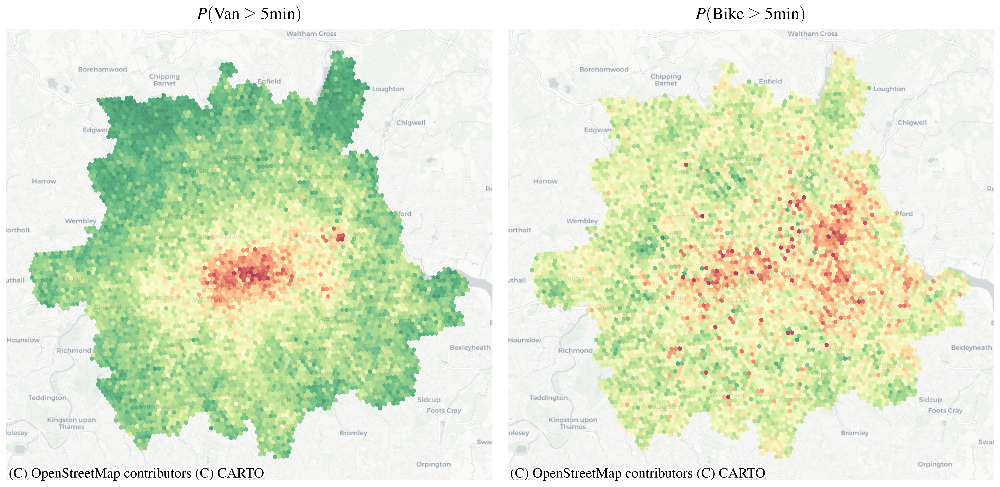

In [65]:
from matplotlib import pyplot as plt
import plotly.express as px
import geopandas as gpd
import branca.colormap as cm
import contextily as ctx
import scienceplots


plt.style.use(["science", "ieee"])


h3_df = pd.concat(
    [gpd.read_parquet(city.h3_file).assign(city=city.name) for city in config.Cities],
    axis=0,
).query("is_city")

plot_df = h3_df.merge(
    city_wise_dataset.test_df.select(
        ["region_id", "xgb-van_quant_0.5", "xgb-bike_quant_0.5", "p_5_van", "p_5_bike"]
    )
    .with_columns(pl.col(pl.FLOAT_DTYPES).fill_null(0))
    .to_pandas(),
    on="region_id",
)

values, _ = px.colors.convert_colors_to_same_type(
    px.colors.diverging.Tealrose_r, colortype="tuple"
)
# cmap = cm.

fig, ax = plt.subplots(1, 2, figsize=(8, 4))

plot_df = plot_df.to_crs(epsg=3857)

plot_df.plot(
    alpha=0.7,
    legend=False,
    column="p_5_van",
    cmap="RdYlGn_r",
    ax=ax[0],
    vmin=0,
    vmax=0.5,
)

plot_df.plot(
    alpha=0.7,
    legend=False,
    column="p_5_bike",
    cmap="RdYlGn_r",
    ax=ax[1],
    vmin=0,
    vmax=0.5,
)

# turn the legend off for the second plot


ctx.add_basemap(ax[0], source=ctx.providers.CartoDB.Positron)
ax[0].axes.set_axis_off()
ax[0].set_axisbelow(True)

ctx.add_basemap(ax[1], source=ctx.providers.CartoDB.Positron)
ax[1].axes.set_axis_off()


# remove the colorbar from the first plot


# add a title to the subplots
ax[0].set_title("$P(\\text{Van} \\geq 5 \\text{min})$")
ax[1].set_title("$P(\\text{Bike} \\geq 5 \\text{min})$")

fig.tight_layout()

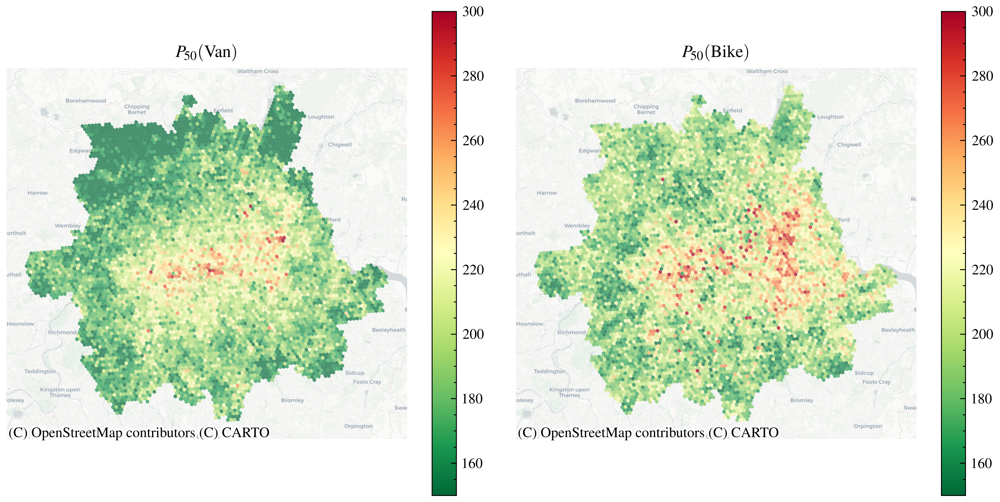

In [66]:
fig, ax = plt.subplots(1, 2, figsize=(8, 4))

plot_df = plot_df.to_crs(epsg=3857)

plot_df.plot(
    alpha=0.7,
    legend=True,
    column="xgb-van_quant_0.5",
    cmap="RdYlGn_r",
    ax=ax[0],
    vmin=150,
    vmax=300,
)

plot_df.plot(
    alpha=0.7,
    legend=True,
    column="xgb-bike_quant_0.5",
    cmap="RdYlGn_r",
    ax=ax[1],
    vmin=150,
    vmax=300,
)

# turn the legend off for the second plot


ctx.add_basemap(ax[0], source=ctx.providers.CartoDB.Positron)
ax[0].axes.set_axis_off()
# ax[0].set_axisbelow(True)

ctx.add_basemap(ax[1], source=ctx.providers.CartoDB.Positron)
ax[1].axes.set_axis_off()


# remove the colorbar from the first plot


# add a title to the subplots
ax[0].set_title("$P_{50}(\\text{Van})$")
ax[1].set_title("$P_{50}(\\text{Bike})$")

fig.tight_layout()

<Axes: >

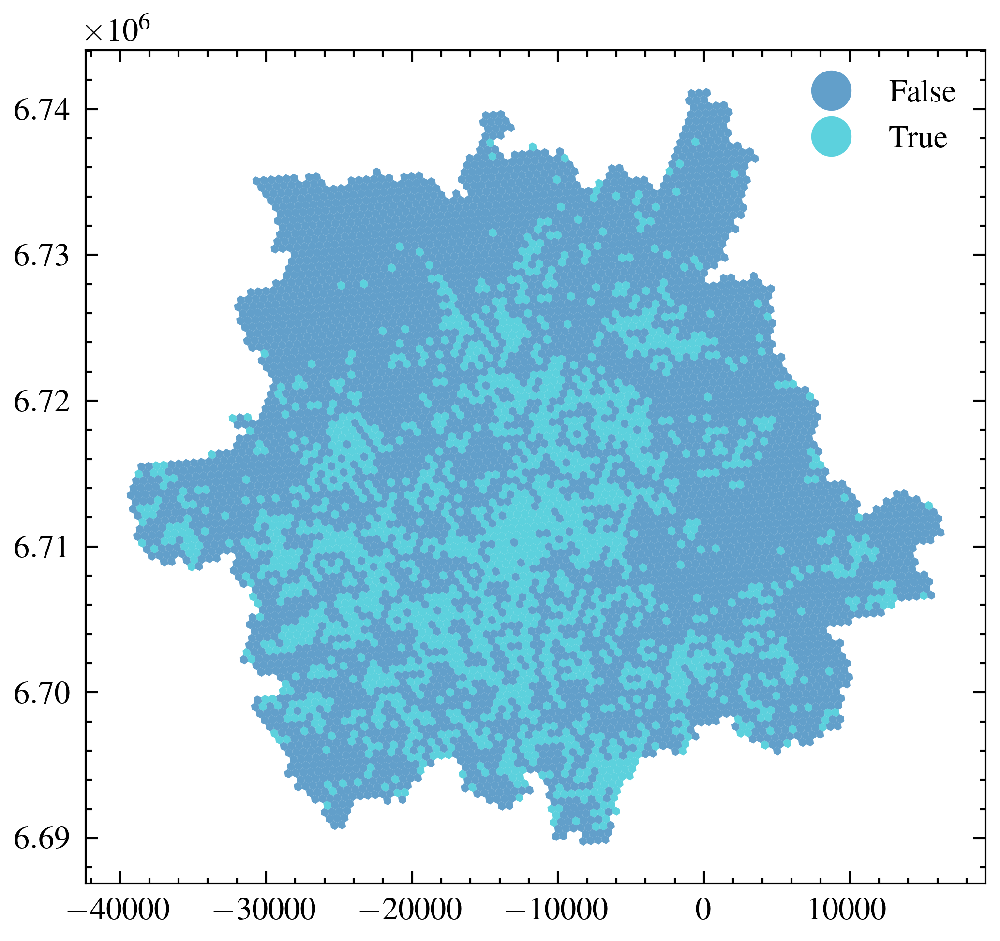

In [68]:
fig, ax = plt.subplots(figsize=(4, 4))

plot_df = plot_df.to_crs(epsg=3857)

plot_df["adv_bike"] = plot_df["xgb-bike_quant_0.5"] < plot_df["xgb-van_quant_0.5"]

plot_df.plot(
    alpha=0.7,
    legend=True,
    column="adv_bike",
    # cmap="RdYlGn_r",
    ax=ax,
    # vmin=0,
    # vmax=0.5,
)

### Boston, USA


In [75]:
from itertools import product
from tqdm import tqdm

from src.models.xgboostlss import OPT_PARAMS

results = []

train_cities = [
    "Boston, USA",
    "Seattle, USA",
    "Chicago, USA",
    "Austin, USA",
]
test_cities = ["Boston, USA"]

van_city_dataset = (
    dataset.copy()
    .add_van_label()
    .split_test_train(
        train_cities=train_cities,
        test_cities=test_cities,
        min_points_per_hex_test=1,
        min_points_per_hex_train=5,
        whole_city_test=True,
        assertion_override=True,
        seed=42,
    )
)

bike_city_dataset = (
    dataset.copy()
    .add_van_label()
    .split_test_train(
        train_cities=["London, UK", "Brussels, Belgium"],
        test_cities=test_cities,
        min_points_per_hex_test=1,
        min_points_per_hex_train=5,
        whole_city_test=True,
        assertion_override=True,
        seed=42,
    )
)

bike_city_dataset._test_df = van_city_dataset.test_df


city_wise_dataset = van_city_dataset.group_test_df(
    opps=[
        pl.len(),
        pl.col("city").first(),
        (pl.col("service_time") >= 5 * 60).mean().alias("p_5"),
        (pl.col("service_time") >= 10 * 60).mean().alias("p_10"),
        (pl.col("service_time") >= 2.5 * 60).mean().alias("p_2.5"),
        pl.col(van_city_dataset.feature_cols).first(),
    ]
)

van_model = XGBoostLSSModel(
    name="xgb-van",
    xgboost_params=OPT_PARAMS,
)
van_model.train(
    van_city_dataset,
)

bike_model = XGBoostLSSModel(
    name="xgb-bike",
    xgboost_params=OPT_PARAMS,
)
bike_model.train(bike_city_dataset)

Test cities are not a subset of train cities. Setting train size to 1.0
Test cities are not a subset of train cities. Setting train size to 1.0


In [76]:
city_wise_dataset.test_df = van_model.predicted_quantiles(city_wise_dataset)


van_samples = van_model.predict_samples(
    city_wise_dataset.set_test_vehicle_type(vehicle_type="van"), n=1000
)

city_wise_dataset.test_df = city_wise_dataset.test_df.join(
    pl.DataFrame(
        van_samples,
    )
    .select(
        # pl.concat_list(pl.all()).list.reduce()
        (pl.sum_horizontal(pl.all() >= (2.5 * 60)) / 1000).alias("p_2.5_van"),
        (pl.sum_horizontal(pl.all() >= (5 * 60)) / 1000).alias("p_5_van"),
        (pl.sum_horizontal(pl.all() >= (10 * 60)) / 1000).alias("p_10_van"),
        # "region_id",
    )
    .with_columns(region_id=city_wise_dataset.test_df["region_id"]),
    on="region_id",
)

city_wise_dataset.test_df = bike_model.predicted_quantiles(city_wise_dataset)
bike_samples = bike_model.predict_samples(
    city_wise_dataset.set_test_vehicle_type(vehicle_type="cargo_bike"), n=1000
)

city_wise_dataset.test_df = city_wise_dataset.test_df.join(
    pl.DataFrame(
        bike_samples,
    )
    .select(
        # pl.concat_list(pl.all()).list.reduce()
        (pl.sum_horizontal(pl.all() >= (2.5 * 60)) / 1000).alias("p_2.5_bike"),
        (pl.sum_horizontal(pl.all() >= (5 * 60)) / 1000).alias("p_5_bike"),
        (pl.sum_horizontal(pl.all() >= (10 * 60)) / 1000).alias("p_10_bike"),
        # "region_id",
    )
    .with_columns(region_id=city_wise_dataset.test_df["region_id"]),
    on="region_id",
)

### Plot the Predictions


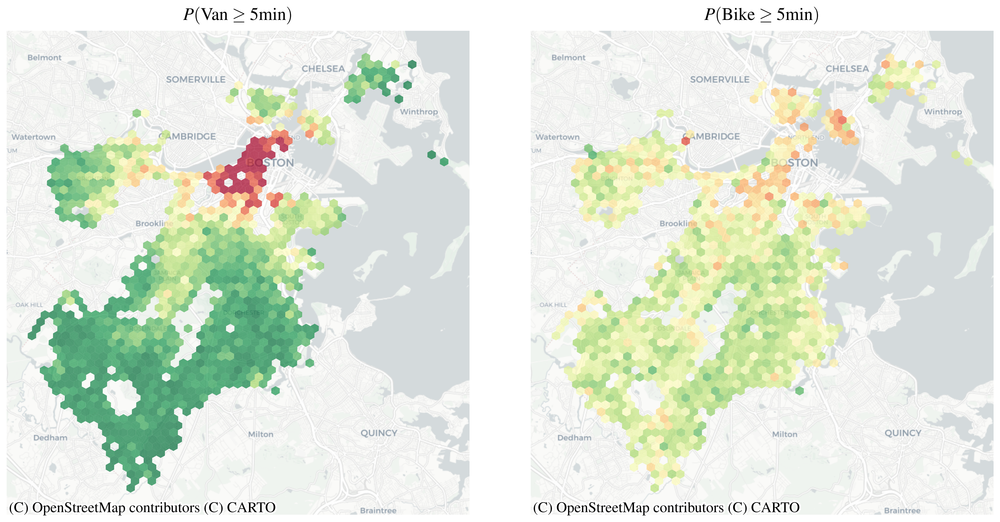

In [77]:
from matplotlib import pyplot as plt
import plotly.express as px
import geopandas as gpd
import branca.colormap as cm
import contextily as ctx
import scienceplots


plt.style.use(["science", "ieee"])


h3_df = pd.concat(
    [gpd.read_parquet(city.h3_file).assign(city=city.name) for city in config.Cities],
    axis=0,
).query("is_city")

plot_df = h3_df.merge(
    city_wise_dataset.test_df.select(
        ["region_id", "xgb-van_quant_0.5", "xgb-bike_quant_0.5", "p_5_van", "p_5_bike"]
    )
    .with_columns(pl.col(pl.FLOAT_DTYPES).fill_null(0))
    .to_pandas(),
    on="region_id",
)

values, _ = px.colors.convert_colors_to_same_type(
    px.colors.diverging.Tealrose_r, colortype="tuple"
)
# cmap = cm.

fig, ax = plt.subplots(1, 2, figsize=(8, 4))

plot_df = plot_df.to_crs(epsg=3857)

plot_df.plot(
    alpha=0.7,
    legend=False,
    column="p_5_van",
    cmap="RdYlGn_r",
    ax=ax[0],
    vmin=0,
    vmax=0.5,
)

plot_df.plot(
    alpha=0.7,
    legend=False,
    column="p_5_bike",
    cmap="RdYlGn_r",
    ax=ax[1],
    vmin=0,
    vmax=0.5,
)

# turn the legend off for the second plot


ctx.add_basemap(ax[0], source=ctx.providers.CartoDB.Positron)
ax[0].axes.set_axis_off()
ax[0].set_axisbelow(True)

ctx.add_basemap(ax[1], source=ctx.providers.CartoDB.Positron)
ax[1].axes.set_axis_off()


# remove the colorbar from the first plot


# add a title to the subplots
ax[0].set_title("$P(\\text{Van} \\geq 5 \\text{min})$")
ax[1].set_title("$P(\\text{Bike} \\geq 5 \\text{min})$")

fig.tight_layout()

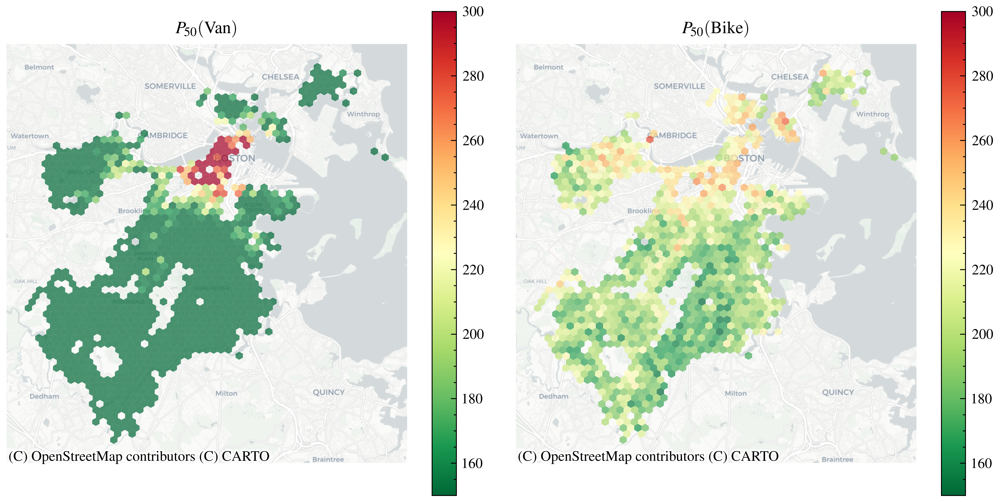

In [78]:
fig, ax = plt.subplots(1, 2, figsize=(8, 4))

plot_df = plot_df.to_crs(epsg=3857)

plot_df.plot(
    alpha=0.7,
    legend=True,
    column="xgb-van_quant_0.5",
    cmap="RdYlGn_r",
    ax=ax[0],
    vmin=150,
    vmax=300,
)

plot_df.plot(
    alpha=0.7,
    legend=True,
    column="xgb-bike_quant_0.5",
    cmap="RdYlGn_r",
    ax=ax[1],
    vmin=150,
    vmax=300,
)

# turn the legend off for the second plot


ctx.add_basemap(ax[0], source=ctx.providers.CartoDB.Positron)
ax[0].axes.set_axis_off()
# ax[0].set_axisbelow(True)

ctx.add_basemap(ax[1], source=ctx.providers.CartoDB.Positron)
ax[1].axes.set_axis_off()


# remove the colorbar from the first plot


# add a title to the subplots
ax[0].set_title("$P_{50}(\\text{Van})$")
ax[1].set_title("$P_{50}(\\text{Bike})$")

fig.tight_layout()

<Axes: >

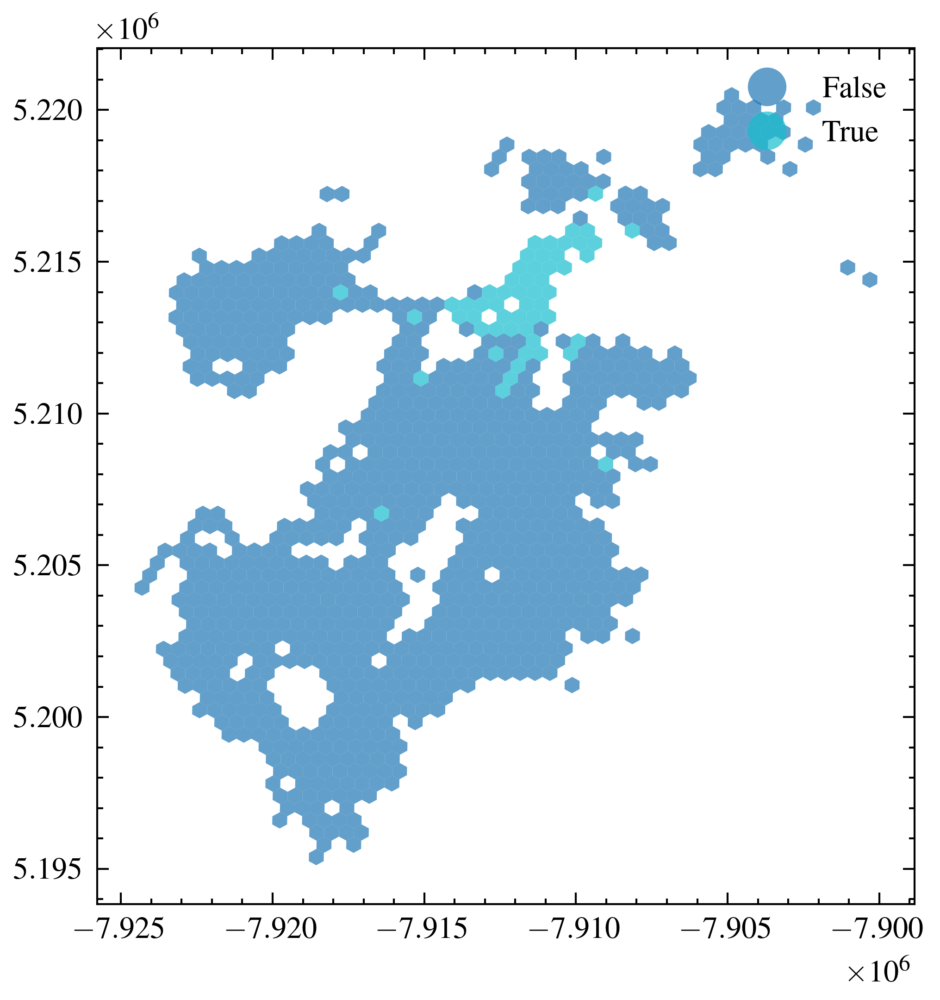

In [79]:
fig, ax = plt.subplots(figsize=(4, 4))

plot_df = plot_df.to_crs(epsg=3857)

plot_df["adv_bike"] = plot_df["xgb-bike_quant_0.5"] < plot_df["xgb-van_quant_0.5"]

plot_df.plot(
    alpha=0.7,
    legend=True,
    column="adv_bike",
    # cmap="RdYlGn_r",
    ax=ax,
    # vmin=0,
    # vmax=0.5,
)

In [86]:
plot_df

,region_id,geometry,is_city,city,p_5_model,p_2.5_model,mean
0,89195da4887ffff,"POLYGON ((-17008.180 6715981.232, -17241.103 6...",True,"London, UK",0.097,0.505,172.004654
1,89194adab63ffff,"POLYGON ((-23243.054 6694181.992, -23475.486 6...",True,"London, UK",0.040,0.310,132.155426
2,89194ad3363ffff,"POLYGON ((-10894.641 6708375.223, -11127.386 6...",True,"London, UK",0.275,0.696,246.438690
3,89194e692d7ffff,"POLYGON ((-9406.622 6730775.894, -9639.876 673...",True,"London, UK",0.010,0.184,106.683937
4,89194e69587ffff,"POLYGON ((-1029.460 6730433.632, -1262.699 673...",True,"London, UK",0.114,0.448,169.452835
...,...,...,...,...,...,...,...
6961,89194e69293ffff,"POLYGON ((-8377.214 6730850.913, -8610.469 673...",True,"London, UK",0.066,0.395,153.485245
6962,89194ada897ffff,"POLYGON ((-19678.337 6699663.254, -19910.891 6...",True,"London, UK",0.058,0.325,136.000687
6963,89194ad8463ffff,"POLYGON ((-30169.772 6703605.900, -30402.422 6...",True,"London, UK",0.065,0.419,156.990631
6964,89194ad1177ffff,"POLYGON ((-12964.095 6701588.050, -13196.688 6...",True,"London, UK",0.135,0.505,181.736557


In [80]:
values

[(0.8156862745098039, 0.34509803921568627, 0.49411764705882355),
 (0.8509803921568627, 0.5372549019607843, 0.5803921568627451),
 (0.8980392156862745, 0.7254901960784313, 0.6784313725490196),
 (0.9450980392156862, 0.9176470588235294, 0.7843137254901961),
 (0.6941176470588235, 0.7803921568627451, 0.7019607843137254),
 (0.4470588235294118, 0.6666666666666666, 0.6313725490196078),
 (0.0, 0.5764705882352941, 0.5725490196078431)]

In [64]:
values

[(0.8156862745098039, 0.34509803921568627, 0.49411764705882355),
 (0.8509803921568627, 0.5372549019607843, 0.5803921568627451),
 (0.8980392156862745, 0.7254901960784313, 0.6784313725490196),
 (0.9450980392156862, 0.9176470588235294, 0.7843137254901961),
 (0.6941176470588235, 0.7803921568627451, 0.7019607843137254),
 (0.4470588235294118, 0.6666666666666666, 0.6313725490196078),
 (0.0, 0.5764705882352941, 0.5725490196078431)]

In [61]:
h3_df.merge(
    test_df.select(["region_id", "p_5"]).to_pandas(),
    on="region_id",
)

,region_id,geometry,is_city,city,p_5
0,89195da4887ffff,"POLYGON ((-0.15279 51.53221, -0.15488 51.53123...",True,"London, UK",0.089
1,89194adab63ffff,"POLYGON ((-0.20880 51.41023, -0.21088 51.40925...",True,"London, UK",0.046
2,89194ad3363ffff,"POLYGON ((-0.09787 51.48969, -0.09996 51.48871...",True,"London, UK",0.240
3,89194e692d7ffff,"POLYGON ((-0.08450 51.61481, -0.08660 51.61383...",True,"London, UK",0.009
4,89194e69587ffff,"POLYGON ((-0.00925 51.61290, -0.01134 51.61193...",True,"London, UK",0.093
...,...,...,...,...,...
6961,89194e69293ffff,"POLYGON ((-0.07525 51.61523, -0.07735 51.61425...",True,"London, UK",0.074
6962,89194ada897ffff,"POLYGON ((-0.17677 51.44093, -0.17886 51.43995...",True,"London, UK",0.049
6963,89194ad8463ffff,"POLYGON ((-0.27102 51.46300, -0.27311 51.46202...",True,"London, UK",0.075
6964,89194ad1177ffff,"POLYGON ((-0.11646 51.45171, -0.11855 51.45073...",True,"London, UK",0.131


In [24]:
samples

array([[ 144.58794 ,  102.876595,  219.94244 , ...,   85.91375 ,
          33.91473 ,  111.960945],
       [ 127.67674 ,   43.95102 ,  132.38484 , ...,  262.32266 ,
          97.684395,  371.2129  ],
       [ 119.03533 ,   97.90244 ,  294.902   , ...,  107.924225,
         229.32191 ,   46.375553],
       ...,
       [ 268.00595 ,  403.07462 ,  230.54419 , ...,  154.91924 ,
         179.70003 ,  155.27118 ],
       [ 102.46912 ,  226.33434 ,  131.8159  , ...,  457.73016 ,
          71.887375,  271.8619  ],
       [ 316.06595 , 1107.9479  ,  112.77011 , ...,  170.6718  ,
         132.79022 ,  113.183304]], dtype=float32)